In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os

os.chdir('/content/drive/MyDrive/Colab Notebooks/')
print("Current Working Directory:", os.getcwd())

Mounted at /content/drive
Current Working Directory: /content/drive/MyDrive/Colab Notebooks


In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Load dataset
df = pd.read_csv("on_street_parking.csv")

# Clean and encode
df_clean = df.dropna(subset=['PRKG_SPLY', 'COLLECTN', 'DISTRICT', 'ST_TYPE']).copy()
df_clean['COLLECTN_ENCODED'] = df_clean['COLLECTN'].map({'FIELD': 1, 'REMOTE': 0})
df_clean['DISTRICT'] = pd.to_numeric(df_clean['DISTRICT'], errors='coerce')
df_clean['ST_TYPE_CODE'] = df_clean['ST_TYPE'].astype('category').cat.codes
df_clean['PRKG_SPLY'] = df_clean['PRKG_SPLY'].clip(upper=200)

street_type_map = dict(enumerate(df_clean['ST_TYPE'].astype('category').cat.categories))
print("Street type map:", street_type_map)

Street type map: {0: 'ALY', 1: 'AVE', 2: 'BLVD', 3: 'CIR', 4: 'CT', 5: 'DR', 6: 'EXPY', 7: 'HL', 8: 'HWY', 9: 'LN', 10: 'LOOP', 11: 'PARK', 12: 'PL', 13: 'PLZ', 14: 'RAMP', 15: 'RD', 16: 'ST', 17: 'TER', 18: 'TUNL', 19: 'WALK', 20: 'WAY'}


In [ ]:
# Select features and scale
features = df_clean[['PRKG_SPLY', 'COLLECTN_ENCODED', 'DISTRICT', 'ST_TYPE_CODE']].dropna()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features)

# Apply KMeans with fixed seed for consistent results
kmeans = KMeans(n_clusters=4, random_state=42)
df_clustered = df_clean.loc[features.index].copy()
df_clustered['CLUSTER'] = kmeans.fit_predict(X_scaled)

# Average parking supply and district per cluster
print(df_clustered.groupby('CLUSTER')[['PRKG_SPLY', 'DISTRICT']].mean())

df_clustered['ST_TYPE_NAME'] = df_clustered['ST_TYPE']
street_type_counts = df_clustered.groupby('CLUSTER')['ST_TYPE_NAME'].value_counts().unstack(fill_value=0)
print(street_type_counts)



         PRKG_SPLY  DISTRICT
CLUSTER                     
0        17.666285  2.617875
1        20.959419  8.754044
2        12.929114  6.073136
3        25.524715  7.948523
ST_TYPE_NAME  ALY   AVE  BLVD  CIR  CT   DR  EXPY  HL  HWY  LN  ...  PARK  PL  \
CLUSTER                                                         ...             
0              12   572   153    0  23   43     0   0    1   7  ...     1  65   
1               0     0     0    0   0    0     0   0    0  15  ...     0   5   
2              42   460   126   25  96  220     2   1    0  72  ...     3  58   
3              11  2654   326   23  64  337     0   0    0   1  ...     0   0   

ST_TYPE_NAME  PLZ  RAMP  RD    ST  TER  TUNL  WALK  WAY  
CLUSTER                                                  
0               0     0  36  2439   31     0     0  103  
1               0     3  16  3317   49     0     0  242  
2               3    22  64  2243   23     1     1   78  
3               0     0   1     2    0     0     

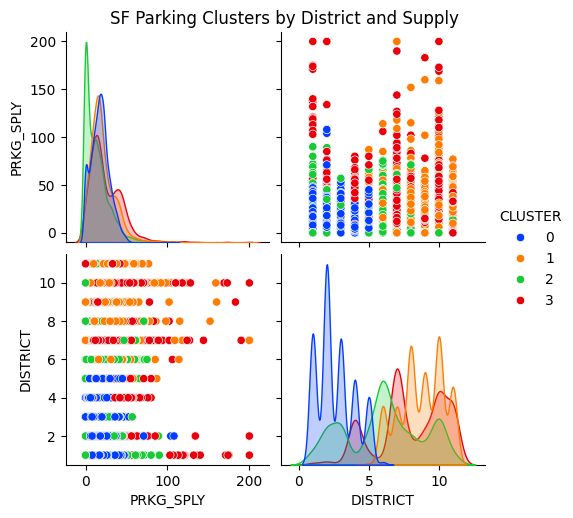

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.pairplot(df_clustered, vars=['PRKG_SPLY', 'DISTRICT'], hue='CLUSTER', palette='bright')
plt.suptitle("SF Parking Clusters by District and Supply", y=1.02)
plt.show()

df_clustered.to_csv("sf_parking_clusters_combined.csv", index=False)


In [ ]:
counts = df['DISTRICT'].value_counts()

for i in range(1, 12):
    print("District " + str(i) + ": " + str(int(df[df['DISTRICT'] == i]['PRKG_SPLY'].mean())))

for element in df['ST_TYPE'].dropna().unique():
    mean_val = df[df['ST_TYPE'] == element]['PRKG_SPLY'].mean()
    if pd.notnull(mean_val):
        print("Street Type " + str(element) + ": " + str(round(mean_val, 2)))

District 1: 24
District 2: 14
District 3: 11
District 4: 28
District 5: 21
District 6: 14
District 7: 21
District 8: 19
District 9: 17
District 10: 21
District 11: 19
Street Type AVE: 23.68
Street Type ST: 18.06
Street Type DR: 28.05
Street Type BLVD: 14.03
Street Type WAY: 19.62
Street Type CT: 7.87
Street Type TER: 14.75
Street Type RD: 19.07
Street Type PL: 2.8
Street Type LOOP: 7.8
Street Type LN: 3.79
Street Type ALY: 1.38
Street Type RAMP: 3.2
Street Type PLZ: 0.0
Street Type CIR: 11.5
Street Type PARK: 14.5
Street Type EXPY: 10.0
Street Type TUNL: 0.0
Street Type HWY: 45.0
Street Type HL: 0.0
Street Type WALK: 0.0


In [ ]:
import re
import numpy as np

def extract_coords(linestring):
    coords = re.findall(r"[-\d\.]+", linestring)
    latitudes = [float(coords[i]) for i in range(0, len(coords), 2)]
    longitudes = [float(coords[i+1]) for i in range(0, len(coords), 2)]
    return pd.Series({"latitude": latitudes, "longitude": longitudes})

df[["longitude", "latitude"]] = df["shape"].apply(extract_coords)

def distance(x1, x2, y1, y2):
    return np.sqrt((x1 - x2) ** 2 + (y1 - y2) ** 2)

distances = []
for i in range(len(df)):
    lat = df.loc[i, "latitude"]
    long = df.loc[i, "longitude"]
    distances.append(distance(lat[0], lat[1], long[0], long[1]) * 1000)

df["distance"] = distances
df["ST_TYPE"] = df["ST_TYPE"].fillna("NA")
df["STREET"] = df["ST_NAME"] + ' ' + df["ST_TYPE"]

def average(x, y):
    return (x + y) / 2

centers = []
for i in range(len(df)):
    latitude, longitude = df.loc[i, "latitude"], df.loc[i, "longitude"]
    centers.append([average(latitude[0], latitude[1]), average(longitude[0], longitude[1])])

df["center"] = centers

df.head()

,objectid,CNN,ST_NAME,ST_TYPE,DISTRICT,COLLECTN,PRKG_SPLY,YEAR,shape,data_as_of,data_loaded_at,longitude,latitude,distance,STREET,center
0,935,1679000,31ST,AVE,1,FIELD,38,2010,"LINESTRING (-122.491436411 37.783591416, -122....",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.491436411, -122.491298863]","[37.783591416, 37.781726073]",1.870407,31ST AVE,"[37.7826587445, -122.491367637]"
1,623,8910000,MCALLISTER,ST,1,FIELD,10,2011,"LINESTRING (-122.454846634 37.77568499, -122.4...",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.454846634, -122.45544067]","[37.77568499, 37.775611298]",0.598589,MCALLISTER ST,"[37.775648144, -122.455143652]"
2,923,2019000,46TH,AVE,1,FIELD,33,2011,"LINESTRING (-122.506821259 37.773407011, -122....",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.506821259, -122.506685314]","[37.773407011, 37.771542479]",1.869481,46TH AVE,"[37.772474745, -122.5067532865]"
3,2239,5954000,FULTON,ST,1,FIELD,17,2011,"LINESTRING (-122.507750665 37.771495034, -122....",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.507750665, -122.508823169]","[37.771495034, 37.771445516]",1.073647,FULTON ST,"[37.771470275, -122.50828691699999]"
4,781,389000,08TH,AVE,1,FIELD,47,2010,"LINESTRING (-122.466562653 37.782849408, -122....",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.466562653, -122.466426902]","[37.782849408, 37.780924588]",1.929601,08TH AVE,"[37.781886998, -122.4664947775]"


In [ ]:
# Create columns of the datasets based on the means of "PRKG_SPLY" for each district and street type.

district_means = {}
street_type_means = {}

for i in range(1, 12):
    district_means[i] = int(df[df['DISTRICT'] == i]['PRKG_SPLY'].mean())

print(district_means)

for element in df["ST_TYPE"].unique():
    if(not pd.isna(element)):
        street_type_means[element] = int(df[df['ST_TYPE'] == element]['PRKG_SPLY'].mean())

print(street_type_means)

district_weights = []
street_type_weights = []

for i in range(len(df)):
    district_weights.append(district_means[df.loc[i, "DISTRICT"]])
    if(not pd.isna(df.loc[i, "ST_TYPE"])):
        street_type_weights.append(street_type_means[df.loc[i, "ST_TYPE"]])
    else:
        street_type_weights.append(np.nan)

df["district_weight"] = district_weights
df["street_type_weight"] = street_type_weights

df.head()

{1: 24, 2: 14, 3: 11, 4: 28, 5: 21, 6: 14, 7: 21, 8: 19, 9: 17, 10: 21, 11: 19}
{'AVE': 23, 'ST': 18, 'DR': 28, 'BLVD': 14, 'NA': 13, 'WAY': 19, 'CT': 7, 'TER': 14, 'RD': 19, 'PL': 2, 'LOOP': 7, 'LN': 3, 'ALY': 1, 'RAMP': 3, 'PLZ': 0, 'CIR': 11, 'PARK': 14, 'EXPY': 10, 'TUNL': 0, 'HWY': 45, 'HL': 0, 'WALK': 0}


,objectid,CNN,ST_NAME,ST_TYPE,DISTRICT,COLLECTN,PRKG_SPLY,YEAR,shape,data_as_of,data_loaded_at,longitude,latitude,distance,STREET,center,district_weight,street_type_weight
0,935,1679000,31ST,AVE,1,FIELD,38,2010,"LINESTRING (-122.491436411 37.783591416, -122....",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.491436411, -122.491298863]","[37.783591416, 37.781726073]",1.870407,31ST AVE,"[37.7826587445, -122.491367637]",24,23
1,623,8910000,MCALLISTER,ST,1,FIELD,10,2011,"LINESTRING (-122.454846634 37.77568499, -122.4...",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.454846634, -122.45544067]","[37.77568499, 37.775611298]",0.598589,MCALLISTER ST,"[37.775648144, -122.455143652]",24,18
2,923,2019000,46TH,AVE,1,FIELD,33,2011,"LINESTRING (-122.506821259 37.773407011, -122....",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.506821259, -122.506685314]","[37.773407011, 37.771542479]",1.869481,46TH AVE,"[37.772474745, -122.5067532865]",24,23
3,2239,5954000,FULTON,ST,1,FIELD,17,2011,"LINESTRING (-122.507750665 37.771495034, -122....",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.507750665, -122.508823169]","[37.771495034, 37.771445516]",1.073647,FULTON ST,"[37.771470275, -122.50828691699999]",24,18
4,781,389000,08TH,AVE,1,FIELD,47,2010,"LINESTRING (-122.466562653 37.782849408, -122....",06/17/2024 10:06:23 AM,06/17/2024 10:08:07 AM,"[-122.466562653, -122.466426902]","[37.782849408, 37.780924588]",1.929601,08TH AVE,"[37.781886998, -122.4664947775]",24,23


In [ ]:
# Helper function to find the nearest street within the dataset, relative to the inputted latitude x and longitude y.
def find_closest_street(x, y):
    min_distance = np.inf
    index = 0
    for i in range(len(df)):
        street = df.loc[i]
        c = street["center"]
        r = distance(x, c[0], y, c[1])
        if(r < min_distance):
            min_distance = r
            index = i
    return df.loc[index]

# The threshold piecewise function to determine needed parking availability.
def threshold(value):
    if(value < 20):
        return value + 20
    if(value < 100):
        return value + 10
    return value

# The main function that iteratively finds the best street based on the inputted current latitude and longitude coordinates.
def optimal_street(x, y):
    current_street = find_closest_street(x, y)
    opt_street = current_street

    p = current_street["PRKG_SPLY"]
    min_distance = np.inf

    for i in range(len(df)):
        street = df.loc[i]
        center = street["center"]
        d = distance(x, center[0], y, center[1])
        if(d < min_distance and street["PRKG_SPLY"] >= threshold(p)):
            min_distance = d
            opt_street = street
    return opt_street

# The function that prints the results of the optimal street function.
def print_optimal_street(x, y):
    current_street = find_closest_street(x, y)
    street = optimal_street(x, y)

    print("Closest Street = " + current_street["STREET"] + ", Parking Supply = " + str(current_street["PRKG_SPLY"]))
    print("Optimal Street = " + street["STREET"] + ", Parking Supply = " + str(street["PRKG_SPLY"]) + "\n")

# Good use cases to try:

# Golden Gate Park: 37.766020, -122.465651
# Pier 39: 37.808378, -122.409837
# Mason St: 37.795808, -122.411677

print_optimal_street(37.775593, -122.436203)

Closest Street = SCOTT ST, Parking Supply = 25
Optimal Street = HAYES ST, Parking Supply = 43



In [ ]:
# Initialize the model

import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

df_2010 = df.loc[df['YEAR'] == 2010]
del df_2010['YEAR']

df_2011 = df.loc[df['YEAR'] == 2011]
del df_2011['YEAR']

df_2012 = df.loc[df['YEAR'] == 2012]
del df_2012['YEAR']

df_2013 = df.loc[df['YEAR'] == 2013]
del df_2013['YEAR']

df_2014 = df.loc[df['YEAR'] == 2014]
del df_2014['YEAR']

## You can change the year which you want to train the data on. Just change '2010' to '2011' for example.
X_train = df_2010[["distance", "district_weight", "street_type_weight"]]
y_train = df_2010['PRKG_SPLY']

## You can also change the test dataset year as you wish.
X_test = df_2011[["distance", "district_weight", "street_type_weight"]]
y_test = df_2011['PRKG_SPLY']

model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [ ]:
from sklearn.metrics import mean_squared_error, r2_score

predictions = model.predict(X_test)

print("Mean squared error:", mean_squared_error(y_test, predictions))
print("R-squared:", r2_score(y_test, predictions))

print("Coefficients:", model.coef_)
print("Intercept:", model.intercept_)

Mean squared error: 98.19957015921936
R-squared: 0.4423618236193898
Coefficients: [11.51927774  0.79063485  0.62118413]
Intercept: -16.216820708469022


##Improving Linear Regression Model

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error

# Part 1: Recalculating K-Means Clusters

df_analysis = df.copy()

dropna_cols = ['PRKG_SPLY', 'COLLECTN', 'DISTRICT', 'ST_TYPE', 'distance',
               'YEAR']
df_analysis.dropna(subset=dropna_cols, inplace=True)

df_analysis['COLLECTN_ENCODED_KMEANS'] = df_analysis['COLLECTN'].map({'FIELD': 1,
                                                                      'REMOTE': 0})
df_analysis['DISTRICT_NUMERIC_KMEANS'] = pd.to_numeric(df_analysis['DISTRICT'],
                                                       errors='coerce')
df_analysis['ST_TYPE_CODE_KMEANS'] = df_analysis['ST_TYPE'].astype('category').cat.codes
df_analysis['PRKG_SPLY_CLIPPED_KMEANS'] = df_analysis['PRKG_SPLY'].clip(upper=200)

kmeans_feature_cols = ['PRKG_SPLY_CLIPPED_KMEANS', 'COLLECTN_ENCODED_KMEANS',
                       'DISTRICT_NUMERIC_KMEANS', 'ST_TYPE_CODE_KMEANS']
df_analysis.dropna(subset=kmeans_feature_cols, inplace=True)

kmeans_new = StandardScaler()
X_scaled_kmeans = kmeans_new.fit_transform(df_analysis[kmeans_feature_cols])
kmeans_model = KMeans(n_clusters=4, random_state=42, n_init='auto')
df_analysis['CLUSTER'] = kmeans_model.fit_predict(X_scaled_kmeans)

In [ ]:
# Part 2: Feature Engineering for Linear Regression (One-Hot Encoding)

df_analysis['PRKG_SPLY_REG_TARGET'] = df_analysis['PRKG_SPLY'].clip(upper=200)
df_analysis['DISTRICT_CAT_REG'] = df_analysis['DISTRICT'].astype(str)
df_ohe_full = pd.get_dummies(df_analysis, columns=['ST_TYPE', 'DISTRICT_CAT_REG'],
                             drop_first=True)

ohe_st_type_cols = [col for col in df_ohe_full.columns if col.startswith('ST_TYPE_')]
ohe_district_cols = [col for col in df_ohe_full.columns if col.startswith('DISTRICT_CAT_REG_')]
regression_features_ohe = ['distance'] + ohe_st_type_cols + ohe_district_cols

In [ ]:
# --- 3. Single Model Linear Regression with OHE ---

X_train_full = df_ohe_full[df_ohe_full['YEAR'] == 2010][regression_features_ohe]
y_train_full = df_ohe_full[df_ohe_full['YEAR'] == 2010]['PRKG_SPLY_REG_TARGET']
X_test_full = df_ohe_full[df_ohe_full['YEAR'] == 2011][regression_features_ohe]
y_test_full = df_ohe_full[df_ohe_full['YEAR'] == 2011]['PRKG_SPLY_REG_TARGET']

# Align columns

common_features_full = list(set(X_train_full.columns) & set(X_test_full.columns))
X_train_full_aligned = X_train_full[common_features_full]
X_test_full_aligned = X_test_full[common_features_full]

model_full_ohe = LinearRegression()
model_full_ohe.fit(X_train_full_aligned, y_train_full)
predictions_full_ohe = model_full_ohe.predict(X_test_full_aligned)

In [ ]:
r2_full = r2_score(y_test_full, predictions_full_ohe)
mse_full = mean_squared_error(y_test_full, predictions_full_ohe)
print(f"Single Regression OHE Model: R2={r2_full:.4f}, MSE={mse_full:.4f}")

orig_r2 = 0.44236
improvement_percentage_full = (((r2_full - orig_r2) / abs(orig_r2) * 100)
                              if orig_r2 != 0 else float('inf'))
print(f"Improvement over original R-squared ({orig_r2:.3f} --> {r2_full:.3f}) : {improvement_percentage_full:.2f}%")

Single Regression OHE Model: R2=0.4941, MSE=89.0847
Improvement over original R-squared (0.442 --> 0.494) : 11.70%


In [ ]:
# Part 4: Clustered Models with OHE & Evaluation

print("\n--- Clustered Linear Regression (OHE Features) ---")
all_y_test_clustered_ohe, all_predictions_clustered_ohe = [], []

for cluster_id in sorted(df_ohe_full['CLUSTER'].unique()):
    cluster_df = df_ohe_full[df_ohe_full['CLUSTER'] == cluster_id]

    X_train_cluster = cluster_df[cluster_df['YEAR'] == 2010][regression_features_ohe]
    y_train_cluster = cluster_df[cluster_df['YEAR'] == 2010]['PRKG_SPLY_REG_TARGET']
    X_test_cluster = cluster_df[cluster_df['YEAR'] == 2011][regression_features_ohe]
    y_test_cluster = cluster_df[cluster_df['YEAR'] == 2011]['PRKG_SPLY_REG_TARGET']

    # Align columns between train and test sets (important for OHE)
    common_features = list(set(X_train_cluster.columns) & set(X_test_cluster.columns))
    X_train_aligned = X_train_cluster[common_features]
    X_test_aligned = X_test_cluster[common_features]

    if (X_train_aligned.empty
        or X_test_aligned.empty
        or y_train_cluster.empty
        or y_test_cluster.empty
        or X_train_aligned.shape[0] < X_train_aligned.shape[1] + 1):

          print(f"Cluster {cluster_id} OHE Model: Insufficient data. Skipping.")
          continue

    model_cluster_ohe = LinearRegression()
    model_cluster_ohe.fit(X_train_aligned, y_train_cluster)
    predictions_cluster_ohe = model_cluster_ohe.predict(X_test_aligned)

    r2_cluster = r2_score(y_test_cluster, predictions_cluster_ohe)
    mse_cluster = mean_squared_error(y_test_cluster, predictions_cluster_ohe)
    print(f"Cluster {cluster_id} OHE Model: R2={r2_cluster:.4f}, MSE={mse_cluster:.4f}")

    all_y_test_clustered_ohe.extend(y_test_cluster)
    all_predictions_clustered_ohe.extend(predictions_cluster_ohe)

if all_y_test_clustered_ohe:
    overall_r2_clustered_ohe = r2_score(all_y_test_clustered_ohe, all_predictions_clustered_ohe)
    print(f"\nOverall R-squared (Clustered OHE models, combined on 2011 test data): {overall_r2_clustered_ohe:.4f}")

    improvement_percentage = ((overall_r2_clustered_ohe - orig_r2) / abs(orig_r2) * 100) if orig_r2 != 0 else float('inf')
    print(f"Improvement over original notebook R-squared (0.4424): {improvement_percentage:.2f}%")
else:
    print("\nNo clusters had enough data for robust overall clustered OHE model evaluation.")


--- Clustered Linear Regression (OHE Features) ---
Cluster 0 OHE Model: R2=0.0440, MSE=125.9216
Cluster 1 OHE Model: Insufficient data. Skipping.
Cluster 2 OHE Model: R2=0.4428, MSE=41.0762
Cluster 3 OHE Model: Insufficient data. Skipping.

Overall R-squared (Clustered OHE models, combined on 2011 test data): 0.6715
Improvement over original notebook R-squared (0.4424): 51.80%


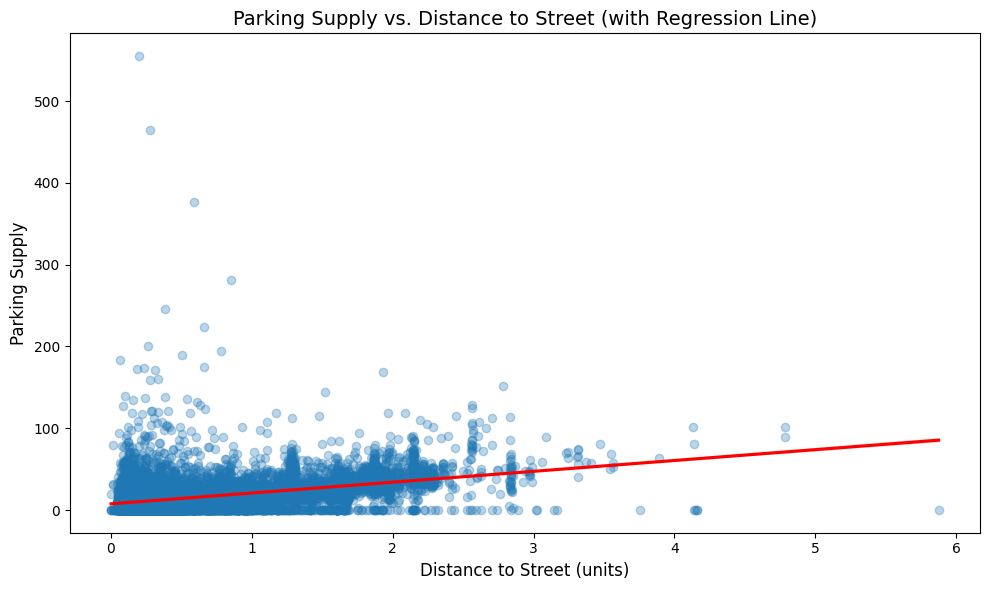

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Parking Supply vs Distance

plt.figure(figsize=(10, 6))
sns.regplot(x='distance', y='PRKG_SPLY', data=df, scatter_kws={'alpha':0.3}, line_kws={'color': 'red'})

plt.title('Parking Supply vs. Distance to Street (with Regression Line)', fontsize=14)
plt.xlabel('Distance to Street (units)', fontsize=12)
plt.ylabel('Parking Supply', fontsize=12)

plt.xticks(fontsize=10) # Increase tick label size
plt.yticks(fontsize=10)

plt.tight_layout()
plt.show()

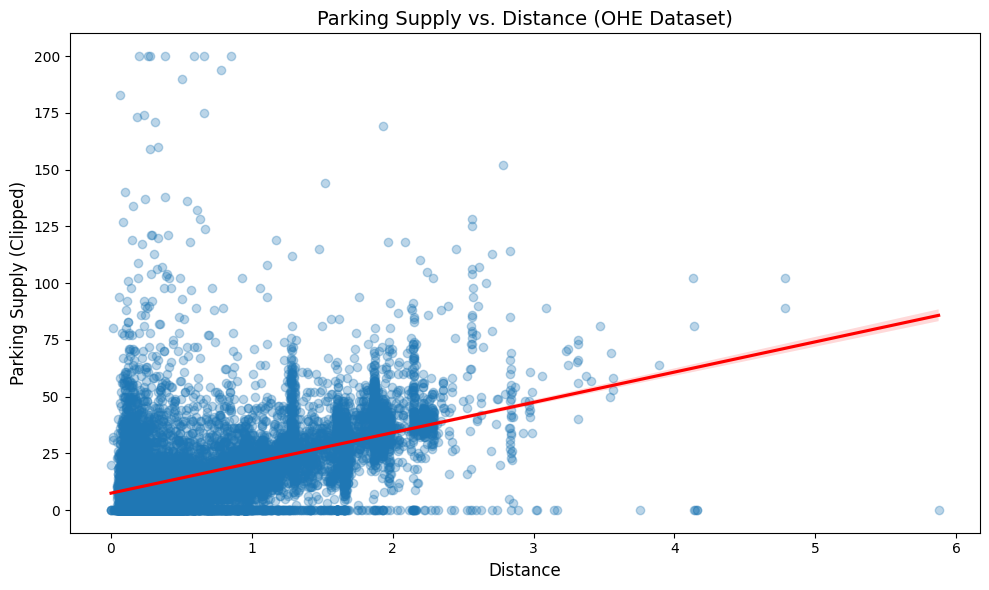

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Example: PRKG_SPLY_REG_TARGET vs. distance
plt.figure(figsize=(10, 6))
sns.regplot(x='distance', y='PRKG_SPLY_REG_TARGET', data=df_ohe_full, scatter_kws={'alpha': 0.3}, line_kws={'color': 'red'})
plt.title('Parking Supply vs. Distance (OHE Dataset)', fontsize=14)
plt.xlabel('Distance', fontsize=12)
plt.ylabel('Parking Supply (Clipped)', fontsize=12)
plt.tight_layout()
plt.show()

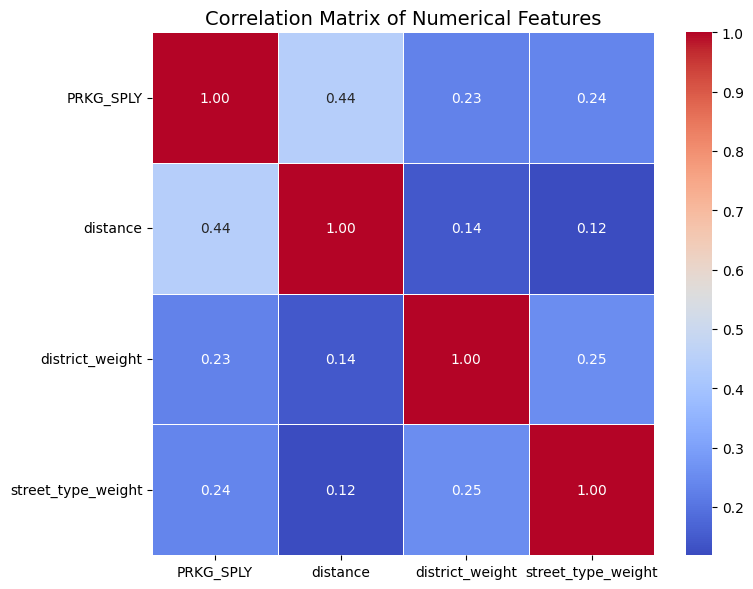

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Correlation Matrix
numerical_cols = ['PRKG_SPLY', 'distance', 'district_weight', 'street_type_weight']

df_corr = df[numerical_cols].dropna()

correlation_matrix = df_corr.corr()

# Create a heatmap of the correlation matrix
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix of Numerical Features', fontsize=14)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

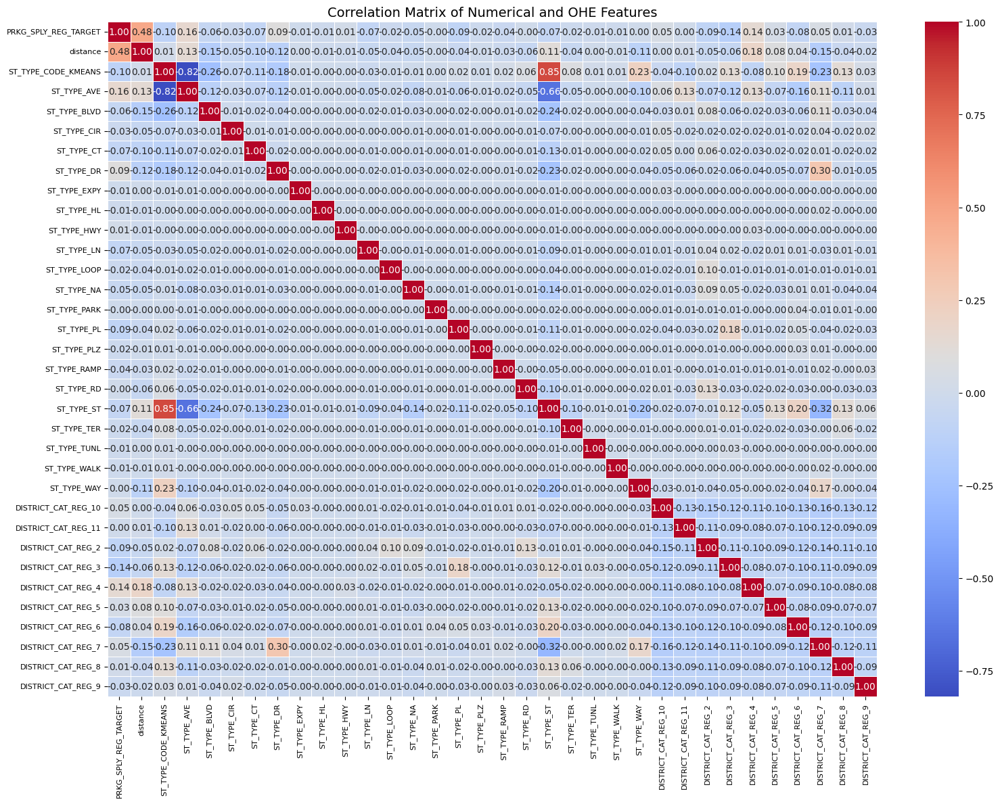

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select numerical columns including district and street type OHE features
numerical_cols_ohe = ['PRKG_SPLY_REG_TARGET', 'distance'] + \
                      [col for col in df_ohe_full.columns if col.startswith('ST_TYPE_')] + \
                      [col for col in df_ohe_full.columns if col.startswith('DISTRICT_CAT_REG_')]
# Drop rows with NaN values in the selected columns
df_corr_ohe = df_ohe_full[numerical_cols_ohe].dropna()

# Calculate the correlation matrix
correlation_matrix_ohe = df_corr_ohe.corr()

# Create a heatmap of the correlation matrix
plt.figure(figsize=(16, 12))  # Larger figure for more features
sns.heatmap(correlation_matrix_ohe, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix of Numerical and OHE Features', fontsize=14)
plt.xticks(fontsize=8) # Reduce font size if needed
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

In [ ]:
import folium

# Good use cases to try:

# Golden Gate Park: 37.766020, -122.465651
# Pier 39: 37.808378, -122.409837
# Mason St: 37.795808, -122.411677

# === Coordinates of interest ===
lat, lon = 37.808378, -122.409837

# Get closest and optimal street info
closest = find_closest_street(lat, lon)
optimal = optimal_street(lat, lon)

# Popup content
popup_html_current = f"""
<b>Current Street:</b> {closest['STREET']}<br>
Supply: {closest['PRKG_SPLY']}<br>
Coordinates: {closest['center']}<br><br>
<b>Suggested Optimal:</b> {optimal['STREET']}<br>
Supply: {optimal['PRKG_SPLY']}<br>
Coordinates: {optimal['center']}
"""

# Popup content
popup_html_optimal = f"""
<b>Suggested Optimal:</b> {optimal['STREET']}<br>
Supply: {optimal['PRKG_SPLY']}<br>
"""

# === Build map ===
m = folium.Map(location=[lat, lon], zoom_start=15)

# Add marker for 'current street'
folium.Marker(
    location=[lat, lon],
    popup=folium.Popup(popup_html_current, max_width=300),
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(m)

# Add marker for 'optimal street'
folium.Marker(
    location=optimal["center"],
    popup=folium.Popup(popup_html_optimal, max_width=300),
    icon=folium.Icon(color='green', icon='check')
).add_to(m)

# === Add availability shading ===
def availability_color(avail):
    if avail >= 30:
        return 'darkgreen'
    elif avail >= 20:
        return 'lightgreen'
    elif avail >= 10:
        return 'yellow'
    elif avail >= 5:
        return 'orange'
    else:
        return 'red'


# Simulate estimated availability
df["EST_AVAILABLE"] = df["PRKG_SPLY"] * 0.3

# Add shaded circle markers
for _, row in df.iterrows():
    if isinstance(row["center"], list) and len(row["center"]) == 2:
        lat_c, lon_c = row["center"]
        est = row["EST_AVAILABLE"]
        color = availability_color(est)

        folium.CircleMarker(
            location=(lat_c, lon_c),
            radius=6,
            color='black',
            fill=True,
            fill_color=color,
            fill_opacity=0.6,
            weight=0.5,
            popup=f"{row['STREET']}<br>Estimated Available: {int(est)}"
        ).add_to(m)

# === Add legend ===
legend_html = """
<div style="position: fixed; bottom: 50px; left: 50px; width: 200px; height: 160px;
     background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
     padding: 10px;">
     <b>Parking Availability</b><br>
     <i style="background:red; width:10px; height:10px; float:left; margin-right:5px;"></i> Very Low (0–4)<br>
     <i style="background:orange; width:10px; height:10px; float:left; margin-right:5px;"></i> Low (5–9)<br>
     <i style="background:yellow; width:10px; height:10px; float:left; margin-right:5px;"></i> Medium (10–19)<br>
     <i style="background:lightgreen; width:10px; height:10px; float:left; margin-right:5px;"></i> High (20–29)<br>
     <i style="background:darkgreen; width:10px; height:10px; float:left; margin-right:5px;"></i> Very High (30+)
</div>
"""

m.get_root().html.add_child(folium.Element(legend_html))

# Show the map
m
